In [1]:
!pip install gym==0.17.3;
!pip install stable-baselines==2.10.2;
!pip install h5py==3.0.0;
!pip install tensorflow==1.13.1;
!pip install tensorboard==1.13.1;
!pip install Keras==2.2.4;
!pip install Keras-Applications==1.0.8;
!pip install Keras-Preprocessing==1.1.2;
!pip install keras-rl==0.4.2;

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.6 MB 4.9 MB/s 
     |████████████████████████████████| 1.0 MB 50.2 MB/s 
  Created wheel for gym: filename=gym-0.17.3-py3-none-any.whl size=1654655 sha256=c5d8892805e50cebb0e4859f56bb2c21e3ea0c18cfc841afcd9ed4baae7112c1
  Stored in directory: /root/.cache/pip/wheels/d1/81/4b/dd9c029691022cb957398d1f015e66b75e37637dda61abdf58
Successfully built gym
  Attempting uninstall: gym
    Found existing installation: gym 0.25.2
    Uninstalling gym-0.25.2:
      Successfully uninstalled gym-0.25.2
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 240 kB 5.0 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.0 MB 5.2 MB/s 
  Attempting uninstall: h5py
    Found existing instal

In [2]:
#Only needed to copy data to local drive can be skipped if zip file is already available in working folder
import shutil

# mount google drive
from google.colab import drive
drive.mount('/content/drive') # for google colab. adjust accordingly
PARENT_DIR = '/content/drive/MyDrive/Wildtrack Group/IQA' 

# copy and extract tar file
shutil.copy(PARENT_DIR + '/data/Annotated_Cropped_WildTrack.zip', 'Cropped_WildTrack.zip')

# get downstream task model
shutil.copy(PARENT_DIR + '/task-amenability/species/model.pt', 'species_model.pt')

shutil.copy(PARENT_DIR + '/task-amenability/object/model.pt', 'object_model.pt')


Mounted at /content/drive


'object_model.pt'

In [3]:
# clone the repository and move data file
!git clone https://github.com/y92lin/wildtrack-iqa.git
!mv Cropped_WildTrack.zip wildtrack-iqa/.
!mv species_model.pt wildtrack-iqa/.
!mv object_model.pt wildtrack-iqa/.
%cd "wildtrack-iqa"
!git checkout task-amenability
!mv species_model.pt taskamenability/taskpredictor/species/model.pt
!mv object_model.pt taskamenability/taskpredictor/objdet/model.pt


Cloning into 'wildtrack-iqa'...
remote: Enumerating objects: 186, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (29/29), done.
remote: Total 186 (delta 13), reused 37 (delta 12), pack-reused 143
Receiving objects: 100% (186/186), 60.02 MiB | 36.89 MiB/s, done.
Resolving deltas: 100% (73/73), done.
/content/wildtrack-iqa
Branch 'task-amenability' set up to track remote branch 'task-amenability' from 'origin'.
Switched to a new branch 'task-amenability'


In [4]:
from zipfile import ZipFile
# extract zip file
with ZipFile('Cropped_WildTrack.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall()

In [5]:
#%cd "wildtrack-iqa"

import torch
import torchvision
from PIL import Image
import torchvision.transforms as T
import matplotlib.pyplot as plt
import cv2
import json
import numpy as np
import albumentations as A

with open('taskamenability/taskpredictor/species/class_mapping.json') as data:
    mappings = json.load(data)

class_mapping = {item['model_idx']: item['class_name'] for item in mappings}
device = torch.device('cpu')
model = torch.jit.load('taskamenability/taskpredictor/species/model.pt').to(device)
transforms = A.load('taskamenability/taskpredictor/species/transforms.json')

In [6]:
from torch.utils import data
import csv
import random
import torch
import yaml
import cv2
import os

from time import process_time
from torch.utils.data import Dataset

root_dir = '/content/wildtrack-iqa'
data_dir = root_dir + '/RAW'

def get_key(val, item_dict):
    for key, value in item_dict.items():
        if val == value:
            return key
    return -1

def createImageSamples(img_shape, num_samples):
  x = np.random.rand(num_samples, img_shape[0], img_shape[1], img_shape[2])
  y = np.random.randint(low=0, high=2, size=(num_samples, 1))
  return (x,y)

def generate_data_sets(sample_percentage=1):

    image_reference_list = []
    subdirectories = list(os.walk(data_dir, topdown=False))[:-1]

    for subdir in subdirectories:
        image_location = subdir[0]
        images = subdir[2]
        species_rating = image_location.rsplit('/', 1)[-1].replace('_', ' ')
        subjective_score = int(species_rating.rsplit(' ', 1)[-1])
        species_class = species_rating.rsplit(' ', 1)[:-1][0]
        if len(species_class.rsplit(' ', 1)) > 1:
            species = species_class.rsplit(' ')[0]
            animal_class = ' '.join(species_class.rsplit(' ')[1:])
        else:
            animal_class = 'Unknown'
            species = species_class

        for image in images:
            class_name = species if animal_class == 'Unknown' else species + ': ' + animal_class
            class_index = get_key(class_name, class_mapping)
            if class_index > -1:
              image_reference = (image_location, species, animal_class, image, class_index, subjective_score)
              image_reference_list.append(image_reference)
    

    # shuffle then split
    seed = 1234
    random.Random(seed).shuffle(image_reference_list)

    train_index = int(len(image_reference_list) * 0.6 * sample_percentage)
    test_index = -int(len(image_reference_list) * 0.2 * sample_percentage) 
    val_index = test_index * 2

    training = image_reference_list[:train_index]
    validation = image_reference_list[val_index:test_index]
    testing = image_reference_list[test_index:]
    return training, validation, testing

def convert_image(img_test):
    image = Image.open(img_test)
    #convert bw to RGB
    bands = image.getbands()
    if len(bands) == 1:
      image = image.convert(mode='RGB')
    image = np.array(image)
    image = transforms(image=image)['image']
    x = torch.from_numpy(image).to(device)
    return x


def transform_images(images):
  x = []
  y = []
  for img in images:
      image_name = img[0]+'/'+img[3]
      image = convert_image(image_name)
      x.append(image)
      y.append(img[4])

  return np.array(x), np.array(y)


In [7]:
# take a percentage of the full data set as a training/test/validation sample
sample_size=.5
train, valid, test = generate_data_sets(sample_size)
x_train, y_train = transform_images(train)
x_val, y_val = transform_images(valid)
x_test, y_test = transform_images(test)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:86: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:86: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


**Execute the below installation only in Colab environment**

In [8]:
from taskamenability.interface import PPOInterface

img_shape = (512,512,3)
task_predictor = model
interface = PPOInterface(x_train, y_train, x_val, y_val, x_test, y_test, task_predictor, img_shape)

Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:529: FutureWarn

init vecmonitor:  tmp/
init resultswriter


Instructions for updating:
Use tf.cast instead.


In [ ]:
# skip training
# interface.train(50)


In [9]:
import shutil

# copy best model to share
#shutil.copy('tmp/best_model.zip', '/content/drive/MyDrive/Wildtrack Group/IQA/task-amenability/best_model.zip')
#interface.load('tmp/best_model.zip')
shutil.copy('/content/drive/MyDrive/Wildtrack Group/IQA/task-amenability/best_model_10_28_2022.zip','tmp/best_model.zip', )
interface.load('tmp/best_model.zip')

Loading a model without an environment, this model cannot be trained until it has a valid environment.


In [10]:
preds = []
class_preds = []
for item in x_test:
  obs = item.permute(2, 0, 1).unsqueeze(dim=0).float()
  y_pred = model(obs)
  y_pred = y_pred.argmax(dim=1).squeeze().item()
  class_preds.append(y_pred)
  preds.append(interface.model.predict(item)[0])

preds = np.rint(np.array(preds).flatten())

In [11]:
class_actuals = [ item[4] for item in test] #item 4 is classification
subjective_quality = [ item[5] for item in test] # item 5 is subjective score


In [12]:
# getting list of images that were scored incorrectly
class_actuals = [ item[4] for item in test]
subjective_quality = [ item[5] for item in test]

sub_low_actual_high = []
sub_high_actual_low = []
for i in range(len(class_actuals)):
  if class_preds[i] == class_actuals[i] and subjective_quality[i] < 4:
    sub_high_actual_low.append(i)
  elif class_preds[i] != class_actuals[i] and subjective_quality[i] >= 4:
    sub_low_actual_high.append(i)
  else:
    pass



In [22]:
# images where subjective scored low but actual classification said it was classifiable
dst_dir = PARENT_DIR + '/Incorrect classification/sub_low_actual_high'
for x in sub_low_actual_high:
  species = test[x][1] + '_' + test[x][2]
  folder = os.path.join(dst_dir, species)
  if not os.path.exists(folder):
    os.mkdir(folder)
  fp = test[x][0] + '/' + test[x][3]
  shutil.copy(fp, folder)



In [21]:
 # images where subjective scored high but actual classification said it was not classifiable
dst_dir = PARENT_DIR + '/Incorrect classification/sub_high_actual_low'
for x in sub_high_actual_low:
  species = test[x][1] + '_' + test[x][2]
  folder = os.path.join(dst_dir, species)
  if not os.path.exists(folder):
    os.mkdir(folder)
  fp = test[x][0] + '/' + test[x][3]
  shutil.copy(fp, folder)


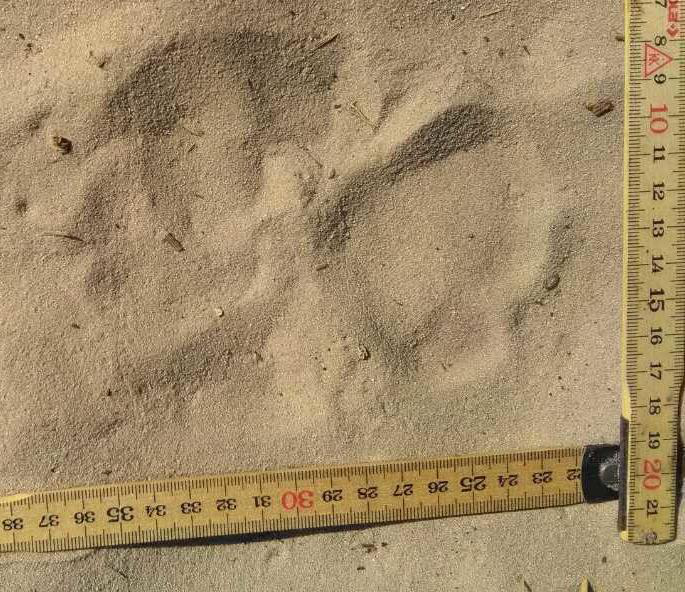

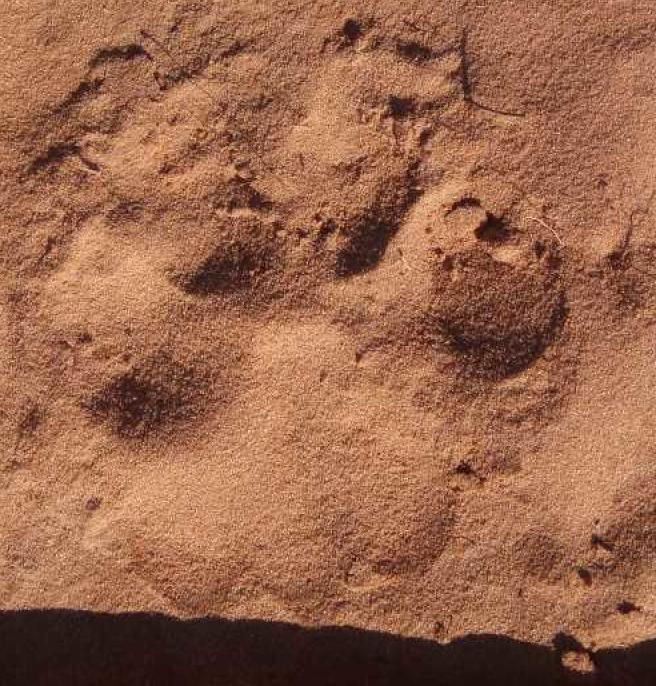

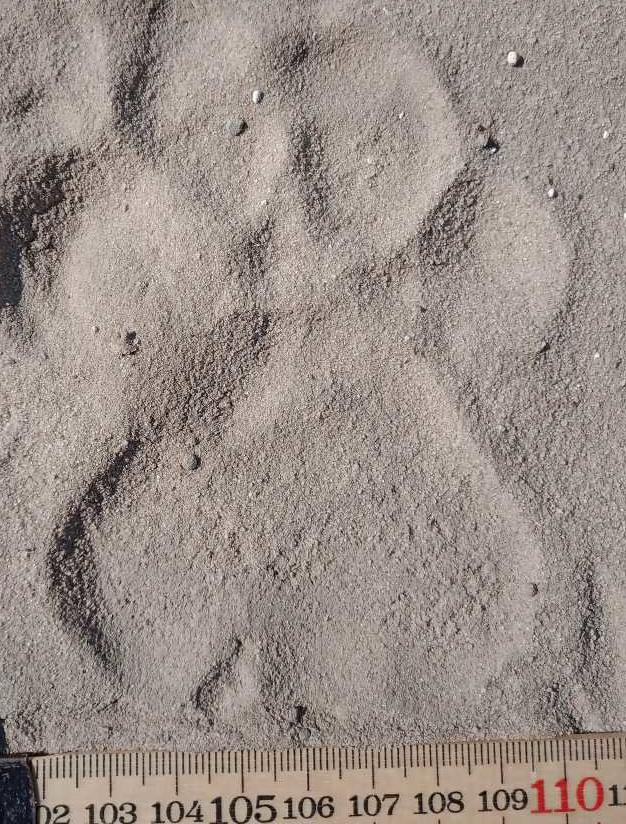

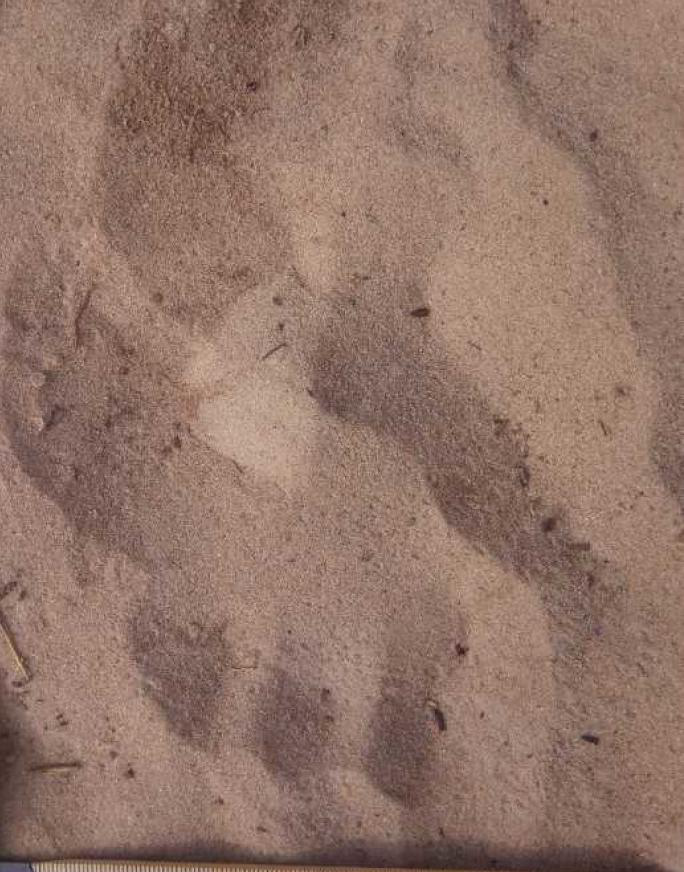

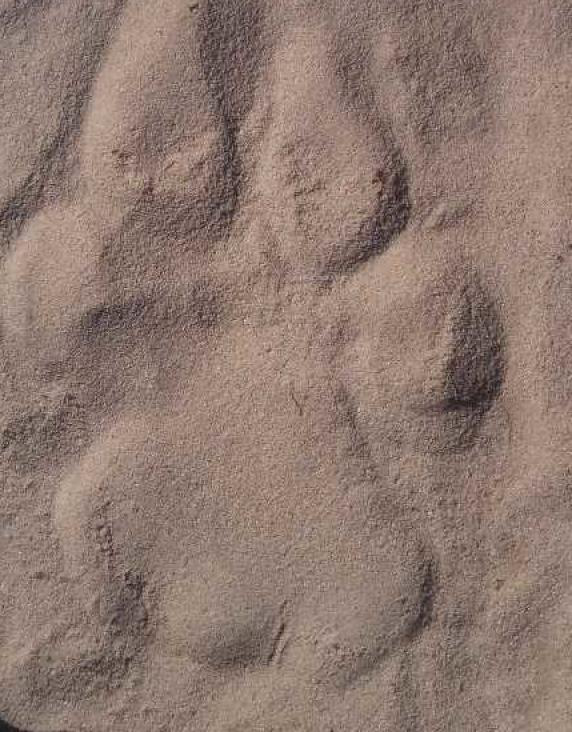

...

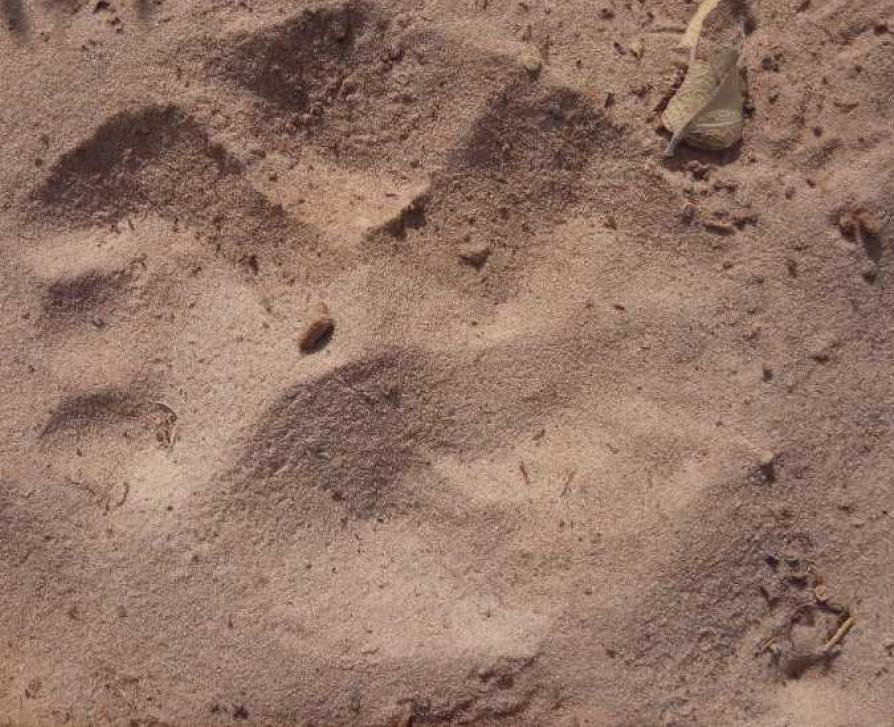

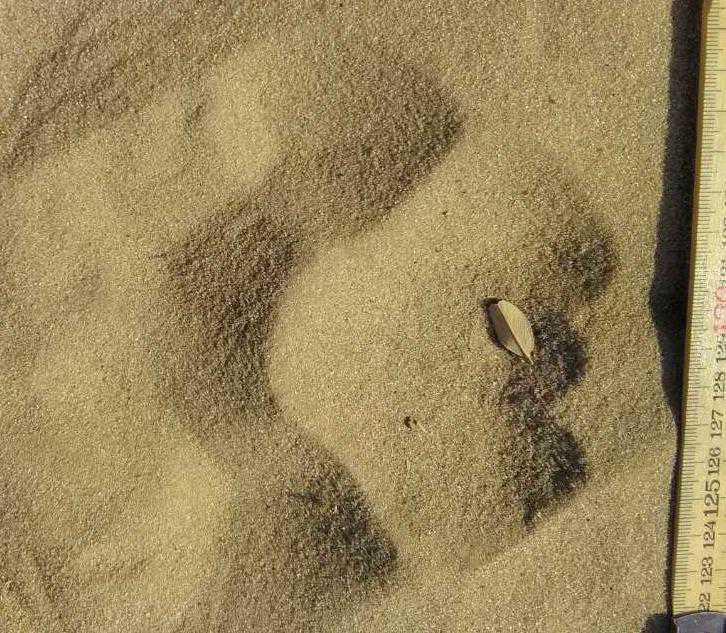

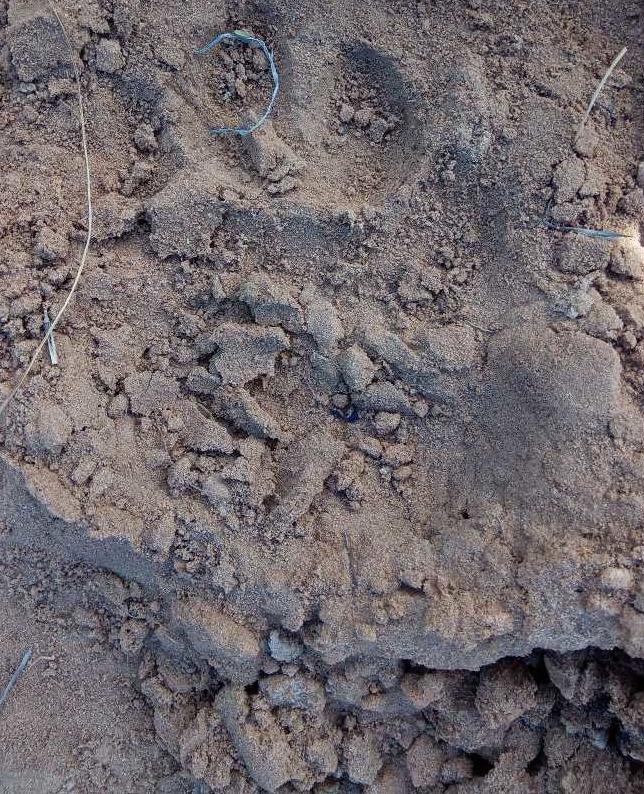

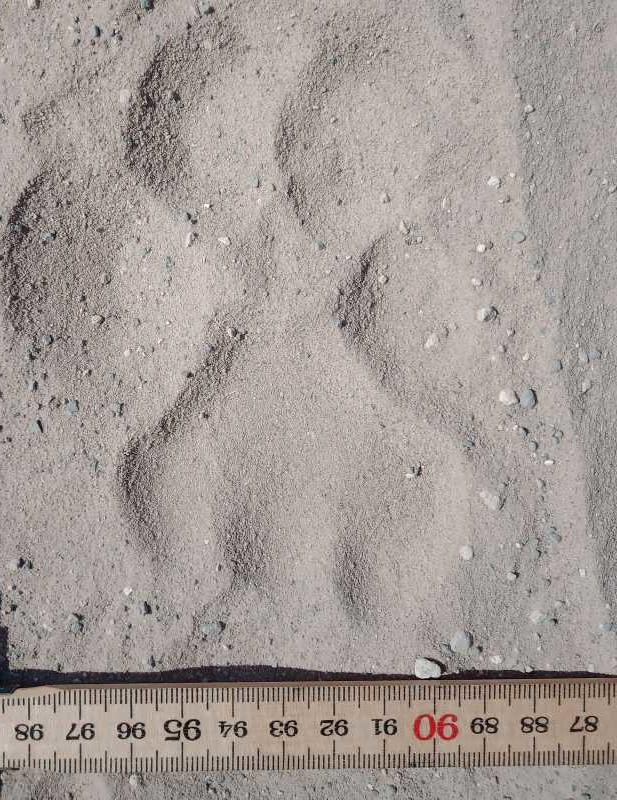

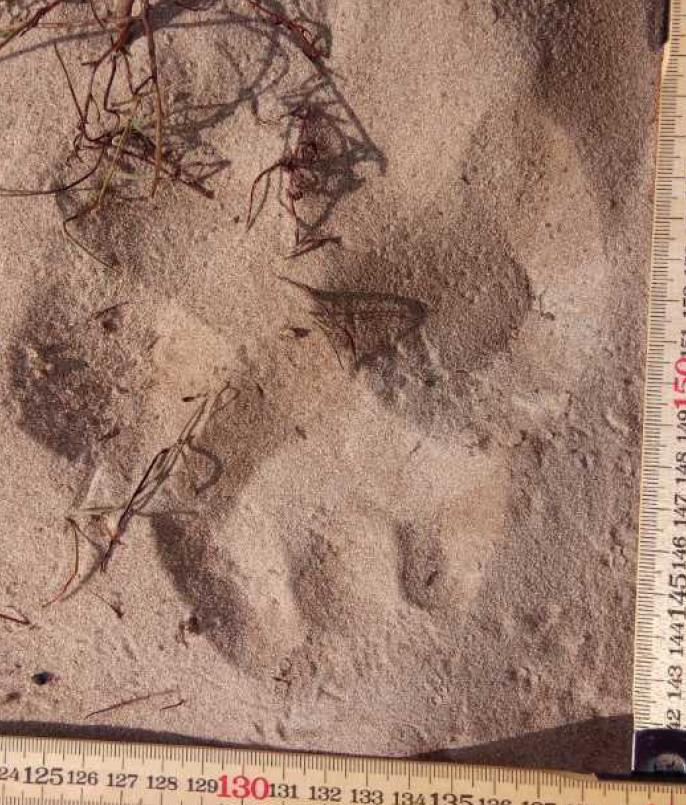

In [23]:
# African lion images where subjective score was 4 or above but was not classifiable 
import IPython.display as display
from PIL import Image

for x in sub_high_actual_low:
  if test[x][1] + '_' + test[x][2] == 'Lion_African':
    fp = test[x][0] + '/' + test[x][3]
    display.display(Image.open(fp))


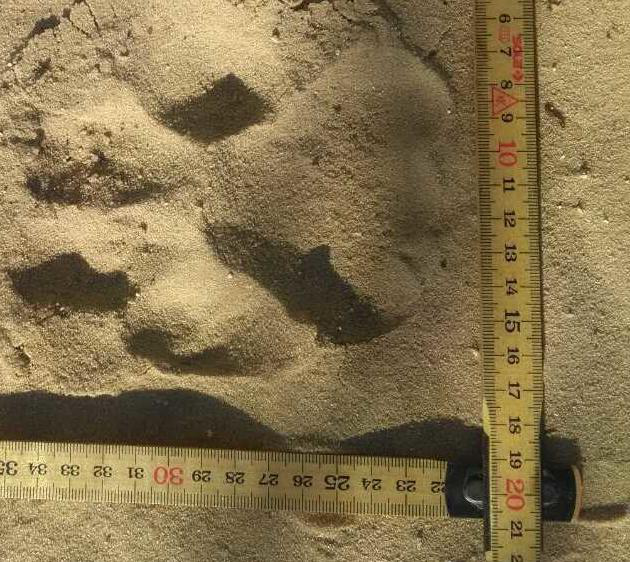

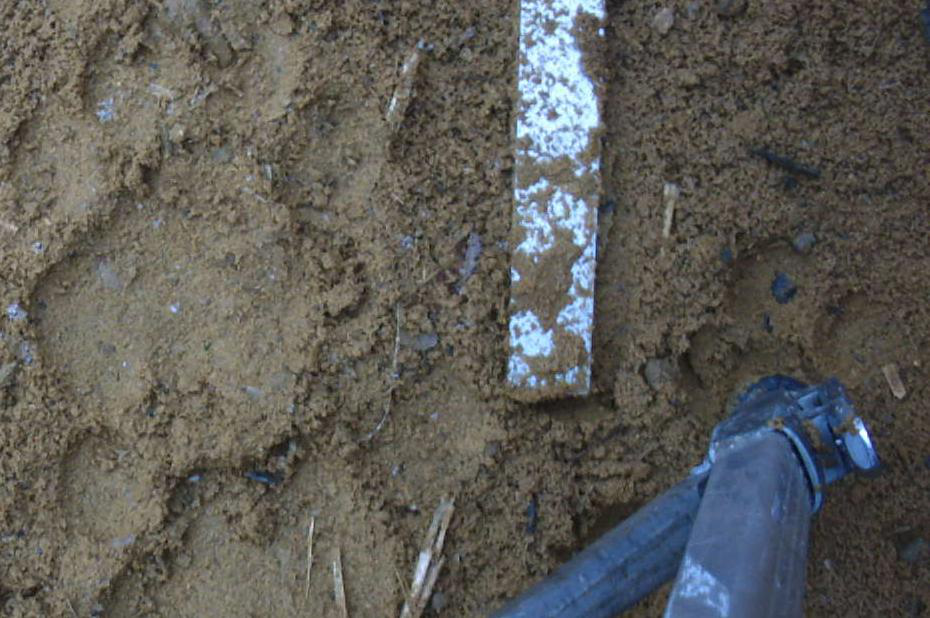

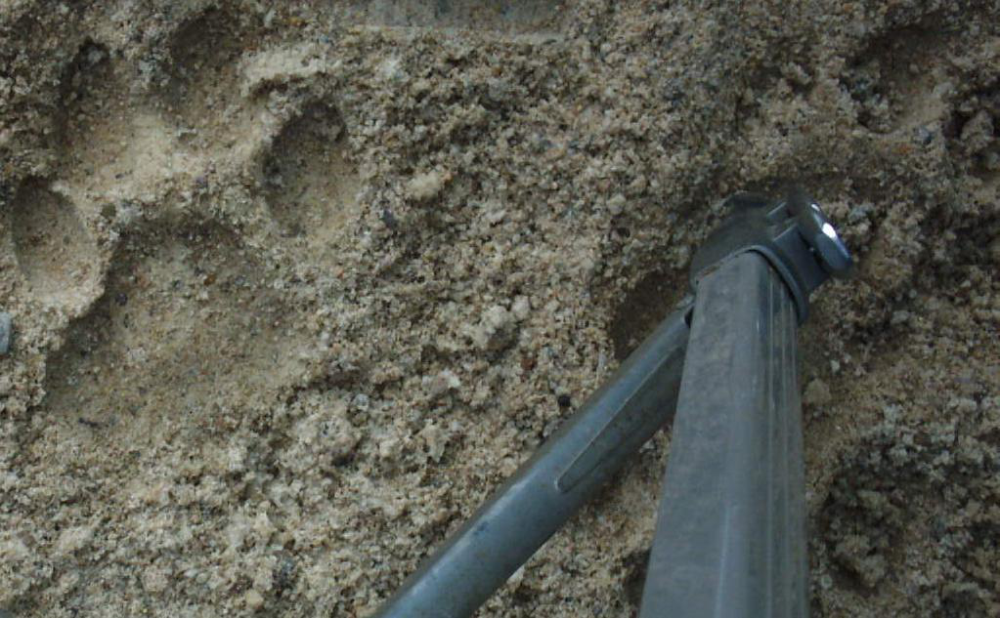

In [24]:
# African lion images where subjective score was below 4but was classifiable 
import IPython.display as display
from PIL import Image

for x in sub_low_actual_high:
  if test[x][1] + '_' + test[x][2] == 'Lion_African':
    fp = test[x][0] + '/' + test[x][3]
    display.display(Image.open(fp))


In the example of African lions (same goes from African Leopards), it seems images with high brightness/exposure tends to be harder to classify. On the contrary images where darker tones are more classifiable.